# Notebook to compare ISSI flow outputs

March 7 2025: All the flows are saved in Globus directory: 

muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

output_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'
directory contains examples of reconstruction

comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'
contains the pdf plots.


# Finding optimal thresholds for MURaM continuum images and magnetic fields to isolate areas within granules and inter-granular lanes (IGL): Bthr and Ithr

Masha: From preliminary analysis I find optimal values of ithr=3.2e8 and bthr=150

In the rest of the analysis we use these ith and bthr to to describe flow reconstruction quality within granules and IGL

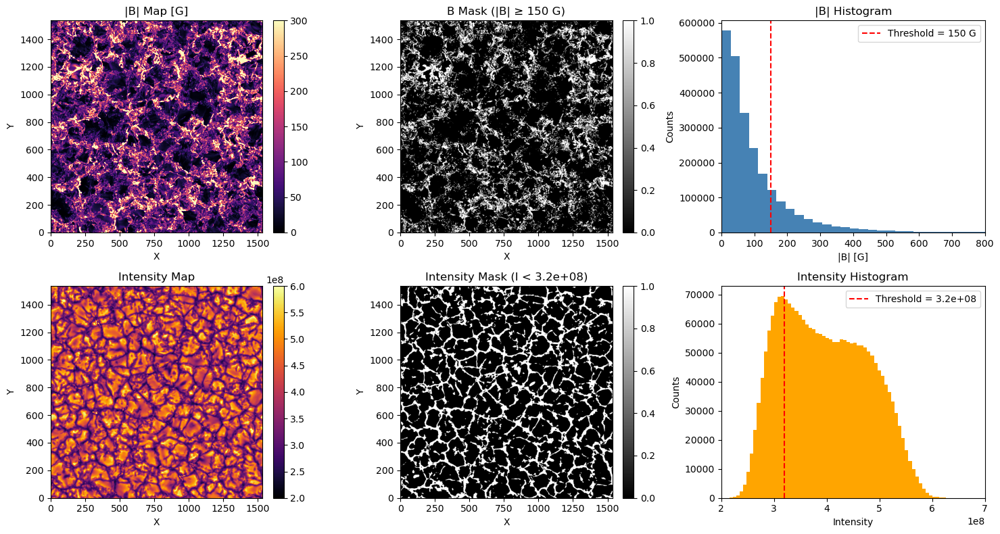

'/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/mask_muram_int_bmag_fwhm0_dt30_tau_slice_1.0.0.pdf'

In [10]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi
import muram as muram
from matplotlib.colors import LogNorm

#muram data renamed ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows to ISSI_MURaM
#before muram_data_path='/Volumes/ISSI_flows_2025/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'
#now: muram_data_path='/Volumes/ISSI_flows_2025/ISSI_MURaM/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/'


muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'
output_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'
comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'

#input data parameters: tau or z; FWHM, dt, indeces for first and last iterations: iter1 and iter2,
#MURaM pixel size nd
tau0=1.0 #1.000  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
fwhm=0 #[100,200,600,1200,2400] km
dt=30 #dt=[30,60,360,720],
iter2=150 
iter1=iter2-dt*5
pixelsize_km=16 #in km
bs=1 #bin size for spatial averaging: no binning [1]
ithr=3.2e8
bthr=150

# reading in MURAM data===================
tau_levels=[tau0]
muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)
b_muram_x = muram_data['b_muram_x']
b_muram_y = muram_data['b_muram_y']
b_muram_z = muram_data['b_muram_z']
intensity=muram_data['intensity']
bmag=np.sqrt(b_muram_x**2 + b_muram_y**2 + b_muram_z**2)


#output pdf file name
pdf_filename='mask_muram_int_bmag_fwhm'+str(fwhm)+'_dt'+str(dt)+'_tau_slice_'+str(tau0)+'.'+str(iter1)+".pdf"
issi.plot_masks_and_histograms(intensity, bmag, ithr, bthr, pdf_filename, directory=output_directory)

# MURAM properties: describing Poynting flux, power spectrum, inductivity 

Checked with Matthias: he gets his outputs to be much more inductive: "At the original resolution I see a correlation of 0.75, with 3x3 binning 0.9, with 6x6 binning 0.96. This is looking at two adjacent time steps
and correlating <dB/dt> and <curl (vXB)>, where <...> denotes the binning operation. The curl was evaluated with the MURaM stencil". Why?

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


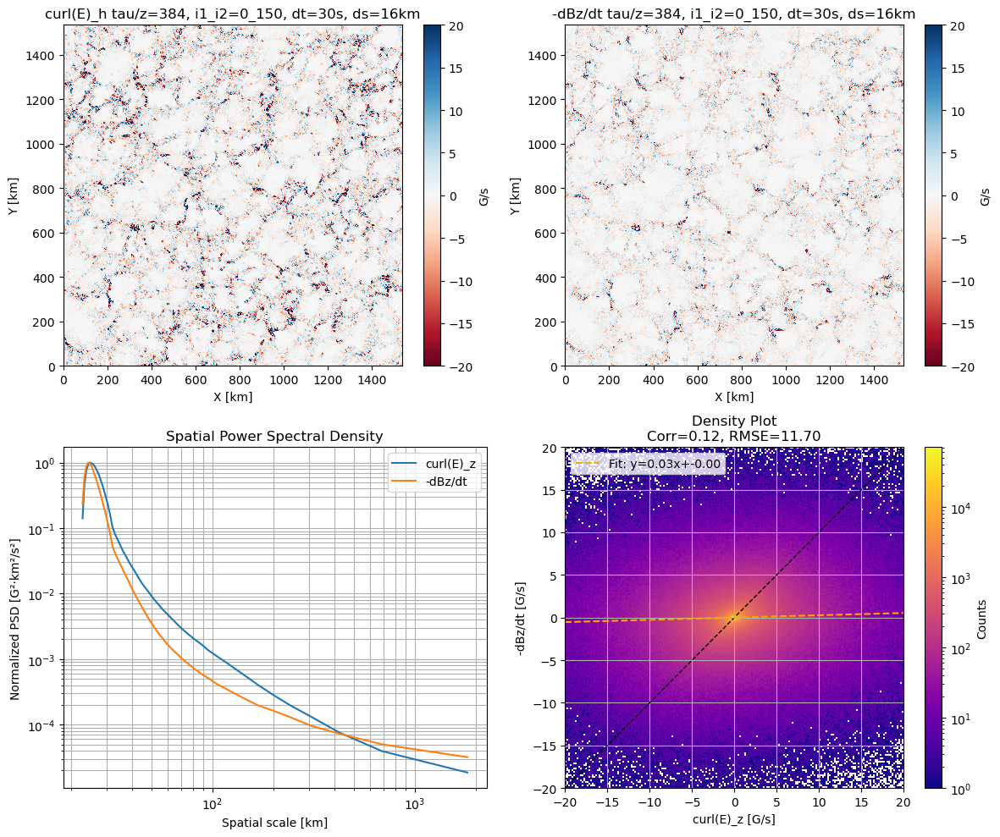

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


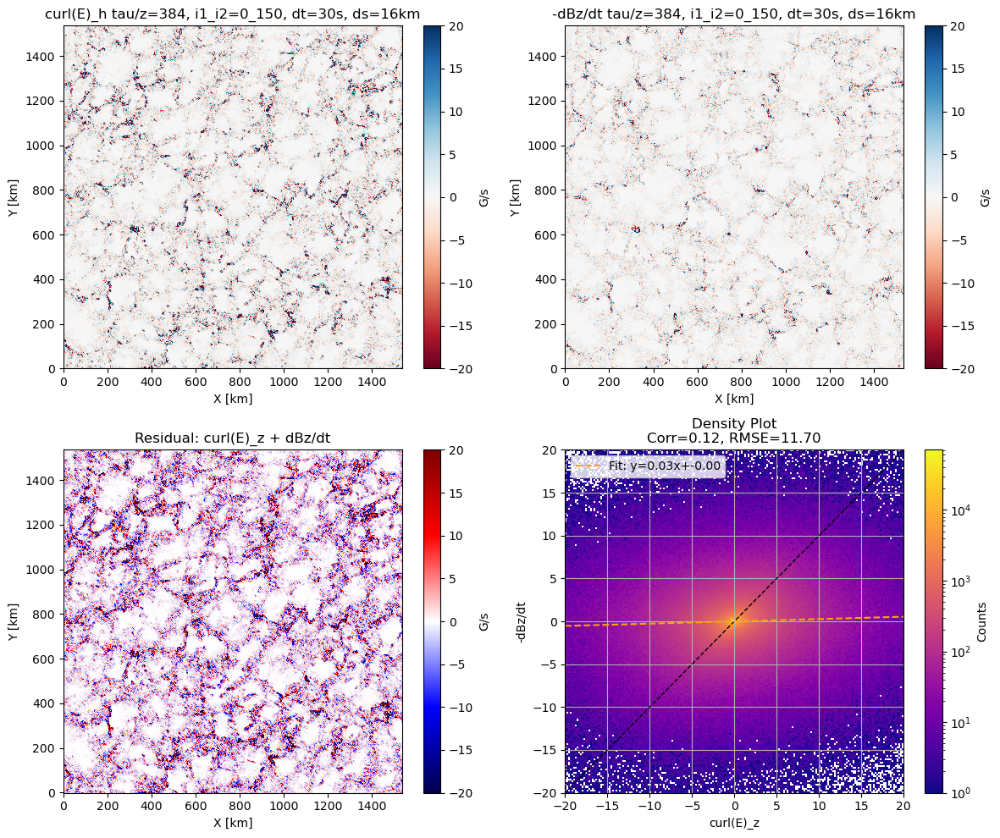

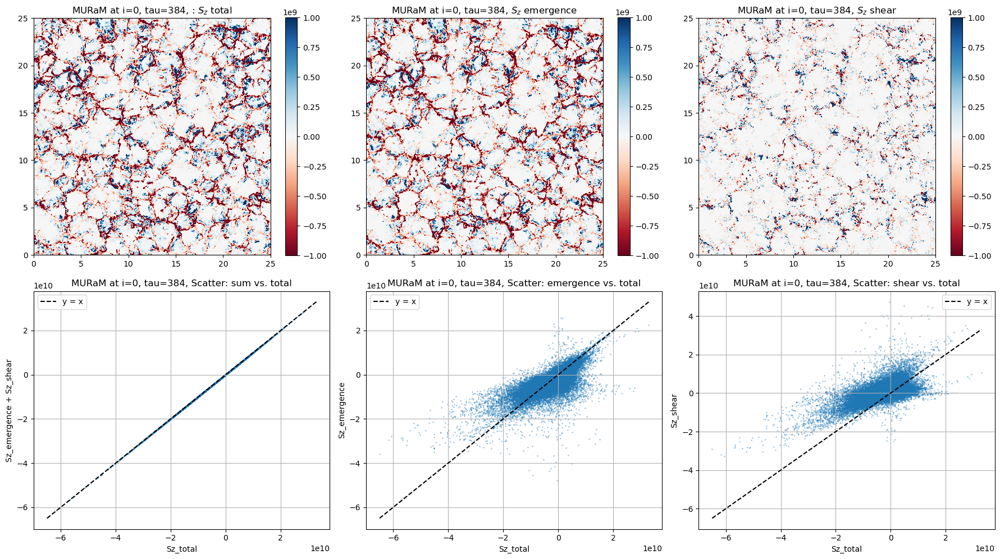

Sz plot saved in: /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/sz_muram_terms_384.0.png


In [3]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi
import muram as muram
from matplotlib.colors import LogNorm

#muram data
#inversion data
tau0=384 #1.000  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
fwhm=100 #[100,200,600,1200,2400] km
iter2=150
dt=30 #dt=[30,60,360,720],
iter1=iter2-dt*5
pixelsize_km=16 #in km
bs=1 #spatial rebinning 
number_of_bins=200 #   number of bins for ax.hist2d

# reading in MURAM data===================
tau_levels=[tau0]
result = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, 
                                               pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)
muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)
s_muram_z = result['s_muram_z']
s_muram_z_emergence = result['s_muram_z_emergence']
s_muram_z_shear = result['s_muram_z_shear']


#Describing MURAM inductivity with PSD
pdf_filename='muram_inductivity_psd_fwhm'+str(fwhm)+'_dt'+str(dt)+'_tau_slice_'+str(tau0)+'.'+str(iter1)+".pdf"
issi.plot_inductive_terms_with_psd(result['curl_Ez'], result['dBz_dt'],
                                   output_directory,pdf_filename, 
                                   title_suffix='tau/z='+str(tau0)+', i1_i2='+str(iter1)+'_'+str(iter2)+', dt='+str(dt)+'s, ds='+str(bs*pixelsize_km)+'km',
                                    bins=number_of_bins,ds0=pixelsize_km*bs)

#Describing MURAM inductivity with difference plot
pdf_filename='muram_inductivity_diff_fwhm'+str(fwhm)+'_dt'+str(dt)+'_tau_slice_'+str(tau0)+'.'+str(iter1)+".pdf"
issi.plot_inductive_terms(result['curl_Ez'], result['dBz_dt'], output_directory,pdf_filename,
                          title_suffix='tau/z='+str(tau0)+', i1_i2='+str(iter1)+'_'+str(iter2)+', dt='+str(dt)+'s, ds='+str(bs*pixelsize_km)+'km',
                          bins=number_of_bins)

#DESCRIBING MURAM SZ contributions due to shear and emergence
issi.plot_sz_component_diagnostics(
    s_muram_z,
    s_muram_z_emergence,
    s_muram_z_shear,
    mask=(bmag > 150),             # Optional mask
    extent=[0, 25, 0, 25],         # Mm
    vmin=-1e9, vmax=1e9,tau0=tau0,iter1=iter1,directory=comparison_directory)            # Set limits for color scale



# Comparison of MURAM Vs. Inverted Velocities: FLCT from Brian Welsch

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


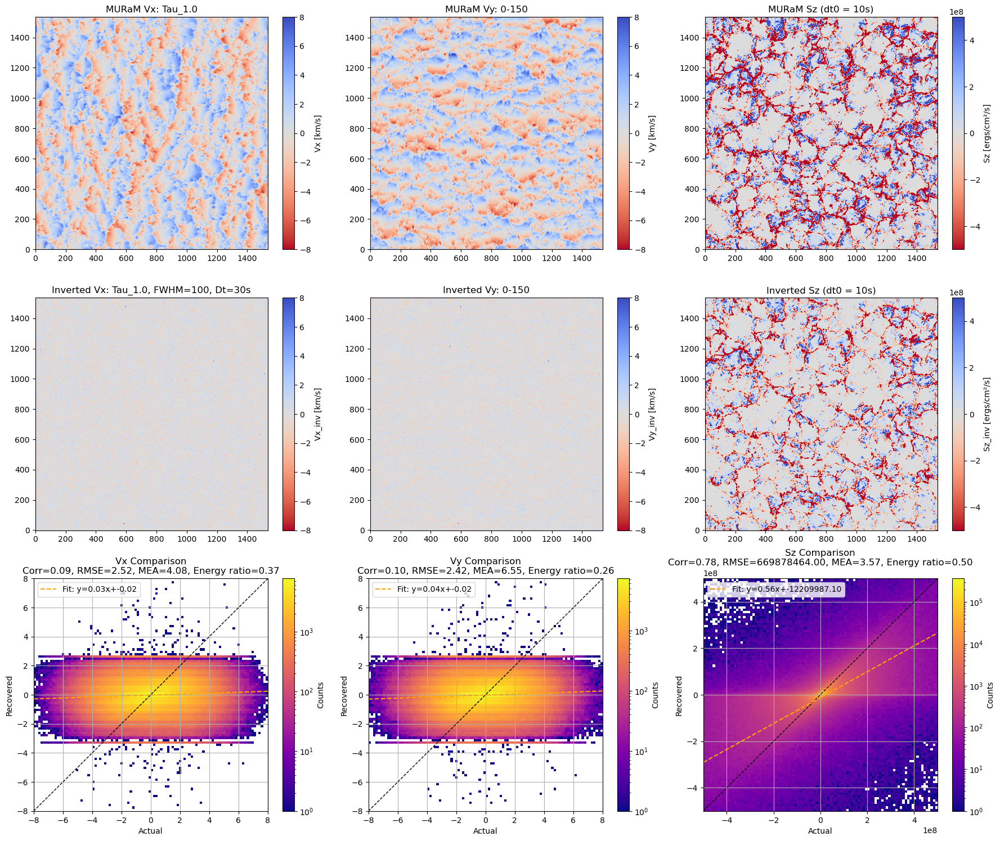

📊 Histogram saved to /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/hist_muram_FLCT_fwhm100_dt30_tau_slice_1.000.000150.pdf


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:1289: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, _ = stats.spearmanr(x_flat, y_flat)
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/pyth

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:2465: RuntimeWarning: overflow encountered in multiply
  denominator = np.sqrt(norm1_sum * norm2_sum)
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:1289: ConstantInputWarni

Inversion file  Tau_1.0/FLCT_fwhm100_dt30_tau_slice_1.000.000150.fits
Muram file /Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/ 0 150 to  <built-in function iter> tau [1.0]


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:2465: RuntimeWarning: overflow encountered in multiply
  denominator = np.sqrt(norm1_sum * norm2_sum)


In [12]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi
import muram as muram
from matplotlib.colors import LogNorm

#muram data
muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

#comparison directory path
comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'


#inversion parameters: BRIAN WELSCH==========================================================
inversion_data_path='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Brian/FLCT_QS_output/'
#opt_or_geom='Yz' # 'Tau' or 'Yz'
tau0=1.0 #1.000  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
fwhm=100 #[100,200,600,1200,2400] km
iter2=150
iter1=iter2-dt*5
pixelsize_km=16 #in km
field_type="velocity" #"velocity" or "electric"
method='Welsch: FLCT Bz'  #'DAVE4VMWDV' #DAVE4VM
bs=1.0
#if set to 1 then compare inductive and non-inductive contribution of electric fields into total Poynting flux
compare_ind_nonind_contrib_to_sz=0 
ithr=3.2e8
bthr=150
#-----------------------

# reading in MURAM data================================================================
tau_levels=[tau0]
# Call the function
muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)
# or without inductivity
#muram_data = issi.load_muram_vars(path, tau0,iter1,iter2,muram,issi,fwhm=fwhm,pixelsize=pixelsize)  
v_muram_x = muram_data['v_muram_x']
v_muram_y = muram_data['v_muram_y']
v_muram_z = muram_data['v_muram_z']
b_muram_x = muram_data['b_muram_x']
b_muram_y = muram_data['b_muram_y']
b_muram_z = muram_data['b_muram_z']
e_muram_x = muram_data['e_muram_x']
e_muram_y = muram_data['e_muram_y']
e_muram_z = muram_data['e_muram_z']
s_muram_z = muram_data['s_muram_z']
s_muram_z_emergence = muram_data['s_muram_z_emergence']
s_muram_z_shear = muram_data['s_muram_z_shear']
int_muram=muram_data['intensity']

#reading in RETRIVED DATA ===============================================================
inv_file=issi.find_welsch_fits_files4iter(inversion_data_path,iter2,fwhm,dt,tau0)
file_path = os.path.join(inversion_data_path+inv_file[0])
v_model_x, v_model_y = issi.extract_welsch_vxvy(file_path) #,fwhm=fwhm)
#calculating E-fields from v and B
e_model_x,e_model_y,e_model_z = issi.calc_e_field_from_v_and_b(v_model_x,v_model_y,v_muram_z,
                                                               b_muram_x,b_muram_y,b_muram_z)
#calculating retrieved Poynting fluxes
s_model_z,s_model_z_emergence,s_model_z_shear = issi.vertical_poynting_flux(v_model_x,v_model_y, v_muram_z, b_muram_x, b_muram_y, b_muram_z)
filename = inv_file[0]
fname=filename[filename.find('/')+1:-5]

#СOMPARISON OF RETRIVED DATA WITH MURaM data===========================================

df=issi.plot_and_metrics_muram_comparison(
    directory=comparison_directory,
    fname=fname,
    fwhm=fwhm,
    dt=dt,
    iter1=iter1,
    iter2=iter2,
    tau_levels=tau_levels,
    i=0,
    method=method,
    v_muram_x=v_muram_x,
    v_muram_y=v_muram_y,
    v_muram_z=v_muram_z,    
    s_muram_z=s_muram_z,
    s_muram_z_emergence=s_muram_z_emergence,
    s_muram_z_shear=s_muram_z_shear,
    int_muram=int_muram,
    v_model_x=v_model_x,
    v_model_y=v_model_y,
    v_model_z=v_muram_x-v_muram_x,
    s_model_z=s_model_z,
    s_model_z_emergence=s_model_z_emergence,
    s_model_z_shear=s_model_z_shear,
    field_type=field_type,
    b_muram_x=b_muram_x,
    b_muram_y=b_muram_y,
    b_muram_z=b_muram_z,
    ithr=ithr,bthr=bthr)

print('Inversion file ', inv_file[0])
print('Muram file',muram_data_path,iter1,iter2,'to ',iter,'tau',tau_levels)
df


#Experimental comparison of Poynting fluxes from curl and curl-free E-field components for Muram and retrieved electric fields derived from flows.
# Plot a 3x3 panel figure comparing inductive, non-inductive, and total vertical Poynting flux (Sz), calculated using
# inductive and non-inductive components of electric fields derived for MURaM and model electric fields 
# using Helmholtz decomposition as described in decompose_electric_field function
# 
if compare_ind_nonind_contrib_to_sz==1:
    file,muram_fluxes,model_fluxes = issi.plot_poynting_decomposition_comparison(directory=comparison_directory,
                                                                                 fname=fname,e_muram_x=e_muram_x,e_muram_y=e_muram_y,
                                                                                 e_model_x=e_model_x,e_model_y=e_model_y,
                                                                                 b_model_x=b_muram_x, b_model_y=b_muram_y,
                                                                                 s_muram_z=s_muram_z,s_model_z=s_model_z,
                                                                                 dx=pixelsize_km, dy=pixelsize_km)

In [7]:
df

,region,field,fwhm,dt,iter1,iter2,tau,method,vector_corr,cosine_sim,...,x_spearmanr,x_rmse,y_slope,y_intercept,y_spearmanr,y_rmse,z_slope,z_intercept,z_spearmanr,z_rmse
0,all,v,200,30,0,150,1.0,Welsch: FLCT Bz,0.008,0.250,...,0.297,8.782000e+00,0.150,0.010,0.293,49.280,0.000,0.000,NaN,2.311
1,all,e,200,30,0,150,1.0,Welsch: FLCT Bz,0.092,0.243,...,0.220,3.550000e-01,0.175,0.000,0.225,0.292,0.184,-0.000,0.300,0.909
2,all,Sz,200,30,0,150,1.0,Welsch: FLCT Bz,0.000,NaN,...,0.782,6.471431e+08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,all,Sz_emergence,200,30,0,150,1.0,Welsch: FLCT Bz,0.000,NaN,...,0.940,3.378065e+08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,all,Sz_shear,200,30,0,150,1.0,Welsch: FLCT Bz,0.000,NaN,...,0.247,5.678100e+08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,B_high,v,200,30,0,150,1.0,Welsch: FLCT Bz,0.156,0.280,...,0.369,3.273000e+00,0.211,-0.010,0.361,2.490,0.000,0.000,NaN,2.637
6,B_high,e,200,30,0,150,1.0,Welsch: FLCT Bz,0.221,0.298,...,0.297,5.650000e-01,0.185,0.000,0.311,0.576,0.193,0.002,0.347,0.843
7,B_high,Sz,200,30,0,150,1.0,Welsch: FLCT Bz,0.000,NaN,...,0.825,1.381964e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,B_high,Sz_emergence,200,30,0,150,1.0,Welsch: FLCT Bz,0.000,NaN,...,0.953,6.681447e+08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,B_high,Sz_shear,200,30,0,150,1.0,Welsch: FLCT Bz,0.000,NaN,...,0.348,1.245572e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# MURAM Vs. Inverted Velocities (FLCT from Meetu Verma) and Comparison of retrieved and actual velocities:

/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Meetu/LCT_QS_tau_Bz/LCT_fwhm0200_dt0030_tau_slice_1.000.000150.fts


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


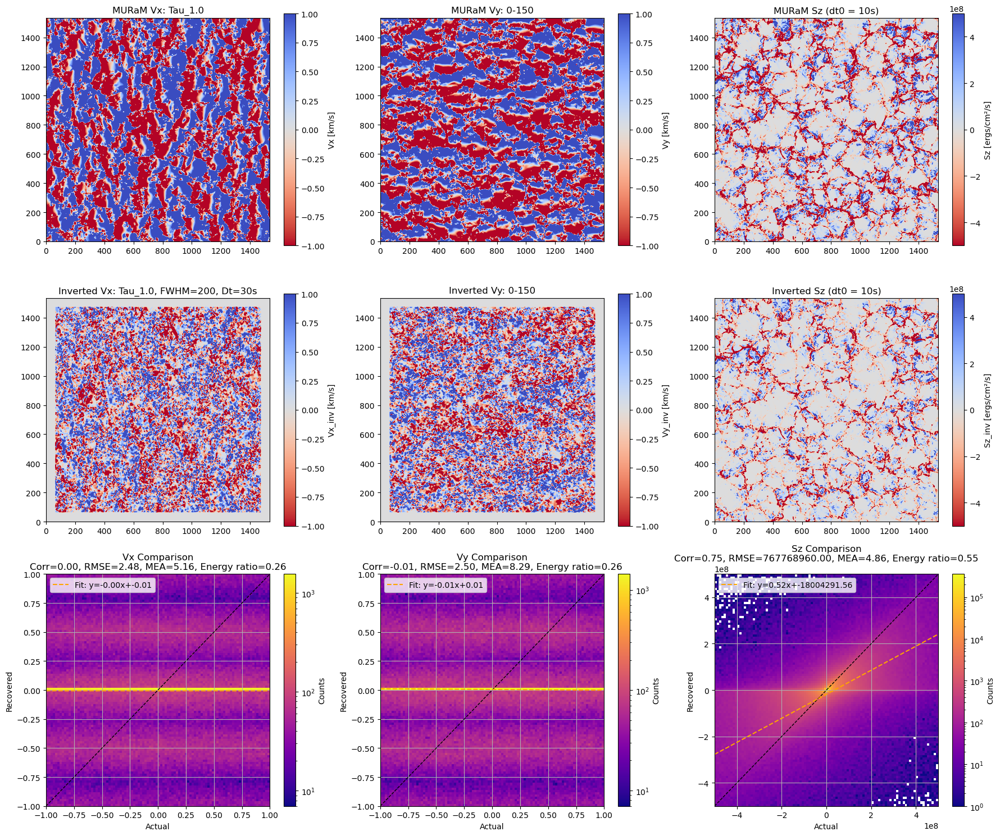

📊 Histogram saved to /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/hist_muram_LCT_fwhm0200_dt0030_tau_slice_1.000.00015.pdf


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:1289: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, _ = stats.spearmanr(x_flat, y_flat)
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/pyth

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:2387: RuntimeWarning: overflow encountered in multiply
  denominator = np.sqrt(norm1_sum * norm2_sum)
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:1289: ConstantInputWarni

Inversion file  LCT_fwhm0200_dt0030_tau_slice_1.000.000150.fts
Muram file /Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/ 0 150 to  <built-in function iter> tau [1.0]


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:2387: RuntimeWarning: overflow encountered in multiply
  denominator = np.sqrt(norm1_sum * norm2_sum)


In [3]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi
import muram as muram
from matplotlib.colors import LogNorm

#muram data
#path='/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'
#path='/Volumes/ISSI_flows_2025/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

#inversion data
#Meetu
#opt_or_geom='Yz' # 'Tau' or 'Yz'

#muram data
muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

#comparison directory path
comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'

#inversion parameters: MEETU VERMA==========================================================

tau0=1.0 #1.000  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
fwhm=200 #[100,200,600,1200,2400] km
iter2=150
iter1=iter2-dt*5
padding_width=64
#specify if to compare velocities tracked on Bz or Iz
iout_or_bz='Bz' #'Iout' (but only for Tau 1.0) and 'Bz' (for all tau and z's)
if iout_or_bz =='Bz':
    if tau0==1.0 or tau0==0.1:
        bz_or_int_str='LCT_QS_tau_Bz' 
    if tau0==384 or tau0==400:
        bz_or_int_str='LCT_QS_yz_Bz'         
if iout_or_bz =='Iout':
    bz_or_int_str='LCT_QS_I/lct_dir'   
#
inversion_data_path='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Meetu/'+bz_or_int_str+'/'
field_type="velocity" #"velocity" or "electric"
method='Verma: FLCT Bz'  #'DAVE4VMWDV' #DAVE4VM
bs=1.0
pixelsize_km=16 #in km


field_type="velocity" #"velocity" or "electric"
method='Welsch: FLCT Bz'  #'DAVE4VMWDV' #DAVE4VM
bs=1.0
#if set to 1 then compare inductive and non-inductive contribution of electric fields into total Poynting flux
compare_ind_nonind_contrib_to_sz=0 
ithr=3.2e8
bthr=150
#if set to 1 then compare inductive and non-inductive contribution of electric fields into total Poynting flux
compare_ind_nonind_contrib_to_sz=0 


# reading in MURAM data================================================================
tau_levels=[tau0]
# Call the function
muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)

# or without inductivity
#muram_data = issi.load_muram_vars(path, tau0,iter1,iter2,muram,issi,fwhm=fwhm,pixelsize=pixelsize)  

# Access specific outputs
v_muram_x = muram_data['v_muram_x']
v_muram_y = muram_data['v_muram_y']
v_muram_z = muram_data['v_muram_z']
b_muram_x = muram_data['b_muram_x']
b_muram_y = muram_data['b_muram_y']
b_muram_z = muram_data['b_muram_z']
e_muram_x = muram_data['e_muram_x']
e_muram_y = muram_data['e_muram_y']
e_muram_z = muram_data['e_muram_z']
s_muram_z = muram_data['s_muram_z']
s_muram_z_emergence = muram_data['s_muram_z_emergence']
s_muram_z_shear = muram_data['s_muram_z_shear']
int_muram=muram_data['intensity']

#reading in RETRIVED DATA ===============================================================

 # Current directory
    
inv_file=issi.find_meetu_fits_files4iter(inversion_data_path,iter2,fwhm,dt,tau0,iout_or_bz)
inv_file

file_path = os.path.join(inversion_data_path+inv_file[0])
print(file_path)
v_model_x, v_model_y = issi.extract_meetu_vxvy(file_path) #,fwhm=fwhm)

#adding padding arround Meetu's dataset
v_model_x = issi.pad_array(v_model_x, xpadding_width=padding_width, ypadding_width=padding_width)
v_model_y = issi.pad_array(v_model_y, xpadding_width=padding_width, ypadding_width=padding_width)

#calculating E-fields from v and B
e_model_x,e_model_y,e_model_z = issi.calc_e_field_from_v_and_b(v_model_x,v_model_y,v_muram_z,
                                                               b_muram_x,b_muram_y,b_muram_z)
#calculating retrieved Poynting fluxes
s_model_z,s_model_z_emergence,s_model_z_shear = issi.vertical_poynting_flux(v_model_x,v_model_y, v_muram_z, b_muram_x, b_muram_y, b_muram_z)
filename = inv_file[0]
fname=filename[filename.find('/')+1:-5]

#СOMPARISON OF RETRIVED DATA WITH MURaM data===========================================

df=issi.plot_and_metrics_muram_comparison(
    directory=comparison_directory,
    fname=fname,
    fwhm=fwhm,
    dt=dt,
    iter1=iter1,
    iter2=iter2,
    tau_levels=tau_levels,
    i=0,
    method=method,
    v_muram_x=v_muram_x,
    v_muram_y=v_muram_y,
    v_muram_z=v_muram_z,    
    s_muram_z=s_muram_z,
    s_muram_z_emergence=s_muram_z_emergence,
    s_muram_z_shear=s_muram_z_shear,
    int_muram=int_muram,
    v_model_x=v_model_x,
    v_model_y=v_model_y,
    v_model_z=v_muram_x-v_muram_x,
    s_model_z=s_model_z,
    s_model_z_emergence=s_model_z_emergence,
    s_model_z_shear=s_model_z_shear,
    field_type=field_type,
    b_muram_x=b_muram_x,
    b_muram_y=b_muram_y,
    b_muram_z=b_muram_z,
    ithr=ithr,bthr=bthr,velrange=1.0)

print('Inversion file ', inv_file[0])
print('Muram file',muram_data_path,iter1,iter2,'to ',iter,'tau',tau_levels)
df


#Experimental comparison of Poynting fluxes from curl and curl-free E-field components for Muram and retrieved electric fields derived from flows.
# Plot a 3x3 panel figure comparing inductive, non-inductive, and total vertical Poynting flux (Sz), calculated using
# inductive and non-inductive components of electric fields derived for MURaM and model electric fields 
# using Helmholtz decomposition as described in decompose_electric_field function
# 
if compare_ind_nonind_contrib_to_sz==1:
    file,muram_fluxes,model_fluxes = issi.plot_poynting_decomposition_comparison(directory=comparison_directory,
                                                                                 fname=fname,e_muram_x=e_muram_x,e_muram_y=e_muram_y,
                                                                                 e_model_x=e_model_x,e_model_y=e_model_y,
                                                                                 b_model_x=b_muram_x, b_model_y=b_muram_y,
                                                                                 s_muram_z=s_muram_z,s_model_z=s_model_z,
                                                                                 dx=pixelsize_km, dy=pixelsize_km)


In [ ]:
#thedor try: 

# MURAM Vs. Inverted Velocities (pyFLCT from Teodor)

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


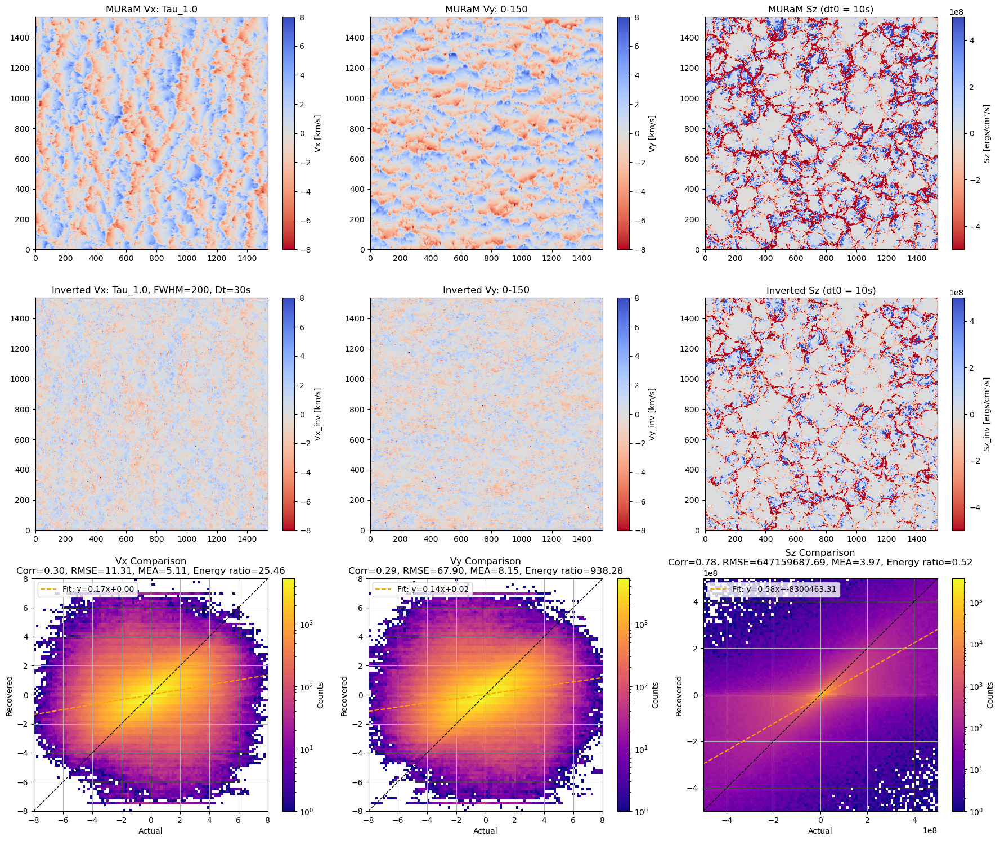

📊 Histogram saved to /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/hist_muram_Teodor_pyFLCT_vx_vy_fwhm_200_dt_30_Bz_tracked_tau_slice_1.0.150.pdf


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:1289: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, _ = stats.spearmanr(x_flat, y_flat)
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/pyth

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use 

Inversion file  TAU_1.0/Teodor_pyFLCT_vx_vy_fwhm_200_dt_30_Bz_tracked.fits


NameError: name 'path' is not defined

In [9]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi

comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'
muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'


#Teodor inversion data
tau0=1.0  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
fwhm=200 #[100,200,600,1200,2400] km
iter2=150
iter1=iter2-dt*5
iout_or_bz='Bz' #'Iout' (but only for Tau 1.0) and 'Bz' (for all tau and z's)
#
if iout_or_bz =='Bz':
    bz_or_int_str='FLCT_Bz' 
if iout_or_bz =='Iout':
    bz_or_int_str='FLCT_Intensity' 
    
inversion_data_path = '/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Teodor/FLCT_QS/'+bz_or_int_str+'/'  # Current directory
pixelsize_km=16 #in km
field_type="velocity" #"velocity" or "electric"
method='Kostic: FLCT '+iout_or_bz
bs=1.0
#if set to 1 then compare inductive and non-inductive contribution of electric fields into total Poynting flux
compare_ind_nonind_contrib_to_sz=0 
ithr=3.2e8
bthr=150


# reading in MURAM data===================
tau_levels=[tau0]
# Call the function
#muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0,iter1,iter2,
#                                                   muram,issi,fwhm=fwhm,pixelsize=pixelsize,dt_s=dt)

muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,
                                                   muram,issi, pixelsize=pixelsize_km,dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)

# or without inductivity
#muram_data = issi.load_muram_vars(path, tau0,iter1,iter2,muram,issi,fwhm=fwhm,pixelsize=pixelsize)  

# Access specific outputs
v_muram_x = muram_data['v_muram_x']
v_muram_y = muram_data['v_muram_y']
v_muram_z = muram_data['v_muram_z']
b_muram_x = muram_data['b_muram_x']
b_muram_y = muram_data['b_muram_y']
b_muram_z = muram_data['b_muram_z']
e_muram_x = muram_data['e_muram_x']
e_muram_y = muram_data['e_muram_y']
e_muram_z = muram_data['e_muram_z']
s_muram_z = muram_data['s_muram_z']
s_muram_z_emergence = muram_data['s_muram_z_emergence']
s_muram_z_shear = muram_data['s_muram_z_shear']
int_muram=muram_data['intensity']

#reading in Teodor data:======================================================

inv_file=issi.find_teodor_fits_files4iter(inversion_data_path,fwhm,dt,iout_or_bz,tau0)
file_path = os.path.join(inversion_data_path+inv_file[0])
v_model_x, v_model_y = issi.extract_teodor_vxvy(file_path,iter2,dt) #,fwhm=fwhm)
e_model_x,e_model_y,e_model_z = issi.calc_e_field_from_v_and_b(v_model_x,v_model_y,v_muram_z,
                                                               b_muram_x,b_muram_y,b_muram_z)
#calculating retrieved Poynting fluxes
s_model_z,s_model_z_emergence,s_model_z_shear = issi.vertical_poynting_flux(v_model_x,v_model_y, v_muram_z, b_muram_x, b_muram_y, b_muram_z)
filename = inv_file[0]
fname=filename[filename.find('/')+1:-5]+'_tau_slice_'+str(tau0)+'.'+str(iter2)


#directory='/Volumes/ISSI_flows_2025/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/issi_inversions/inv_comparisons/'
#issi.plot_masks_and_histograms(int_muram, bmag, ithr, bthr, 
#                               'mask_muram_int_bmag_fwhm'+str(fwhm)+'_dt'+str(dt)+'_tau_slice_'+str(tau0)+'.'+str(iter1)+".pdf",
#                               directory=directory)

#Comparison

df=issi.plot_and_metrics_muram_comparison(
    directory=comparison_directory,
    fname=fname,
    fwhm=fwhm,
    dt=dt,
    iter1=iter1,
    iter2=iter2,
    tau_levels=tau_levels,
    i=0,
    method=method,
    v_muram_x=v_muram_x,
    v_muram_y=v_muram_y,
    v_muram_z=v_muram_z,    
    s_muram_z=s_muram_z,
    s_muram_z_emergence=s_muram_z_emergence,
    s_muram_z_shear=s_muram_z_shear,
    int_muram=int_muram,
    v_model_x=v_model_x,
    v_model_y=v_model_y,
    v_model_z=v_muram_x-v_muram_x,
    s_model_z=s_model_z,
    s_model_z_emergence=s_model_z_emergence,
    s_model_z_shear=s_model_z_shear,
    field_type=field_type,
    b_muram_x=b_muram_x,
    b_muram_y=b_muram_y,
    b_muram_z=b_muram_z,
    ithr=ithr,bthr=bthr)

print('Inversion file ', inv_file[0])
print('Muram file',path,iter1,iter2,'to ',iter,'tau',tau_levels)
df

#Experimental comparison of Poynting fluxes from curl and curl-free E-field components for Muram and retrieved electric fields derived from flows.
# Plot a 3x3 panel figure comparing inductive, non-inductive, and total vertical Poynting flux (Sz), calculated using
# inductive and non-inductive components of electric fields derived for MURaM and model electric fields 
# using Helmholtz decomposition as described in decompose_electric_field function
# 
if compare_ind_nonind_contrib_to_sz==1:
    file,muram_fluxes,model_fluxes = issi.plot_poynting_decomposition_comparison(directory=comparison_directory,
                                                                                 fname=fname,e_muram_x=e_muram_x,e_muram_y=e_muram_y,
                                                                                 e_model_x=e_model_x,e_model_y=e_model_y,
                                                                                 b_model_x=b_muram_x, b_model_y=b_muram_y,
                                                                                 s_muram_z=s_muram_z,s_model_z=s_model_z,
                                                                                 dx=pixelsize_km, dy=pixelsize_km)

# MURAM Vs. Inverted Velocities (DAVE4VM from Jiayi)

Calling with: iter=150, fwhm=0, dt=30, tau=1.0, method=DAVE4VMWDV
Filename: /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Jiayi/QS/Tau_1.0/Liu_DAVE4VMWDV_vx_vy_vz_fwhm0_dt30_tau_slice_1.0.000150.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      28   ()      
  1  VX            1 ImageHDU         8   (1536, 1536)   float64   
  2  VY            1 ImageHDU         8   (1536, 1536)   float64   
  3  VZ            1 ImageHDU         8   (1536, 1536)   float64   


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


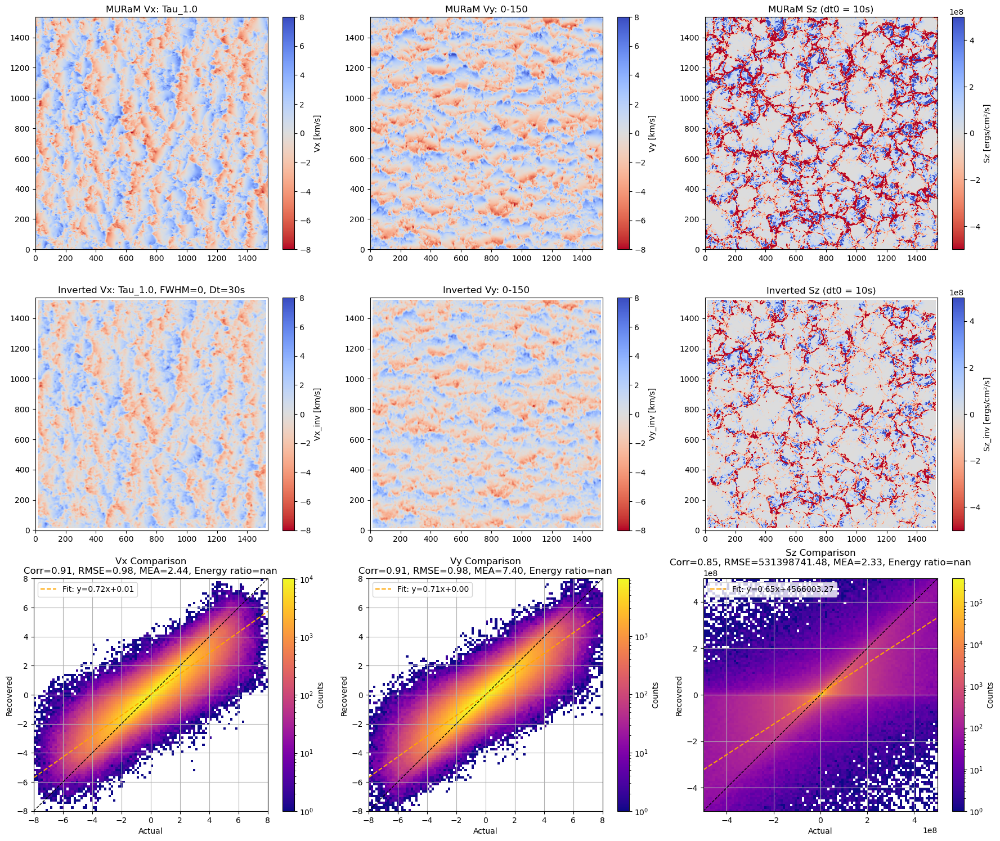

📊 Histogram saved to /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/hist_muram_Liu_DAVE4VMWDV_vx_vy_vz_fwhm0_dt30_tau_slice_1.0.000150.pdf


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Users/maria2022/ssw/masha/muram/issi.py:1289: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, _ = stats.spearmanr(x_flat, y_flat)
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/pyth

/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use 

Inversion file  Tau_1.0/Liu_DAVE4VMWDV_vx_vy_vz_fwhm0_dt30_tau_slice_1.0.000150.fits
Muram file /Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/ 0 150 to  <built-in function iter> tau [1.0]


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [1]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi
import muram as muram

#muram data
muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

#path='/Volumes/ISSI_flows_2025/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

#comparison directory path
comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'

#inversion parameters: JIAYI LIU==========================================================
#e.g. 'Liu_DAVE4VM_vx_vy_vz_fwhm0_dt30_tau_slice_0.1.000150.fits

inversion_data_path= '/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Jiayi/QS/'  # Current directory
tau0=1.0 #384  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
iter2=150
iter1=iter2-dt*5
fwhm=0 #[100,200,600,1200,2400] km
method='DAVE4VMWDV'  #'DAVE4VMWDV' #DAVE4VM
pixelsize=16
field_type="velocity" #"velocity" or "electric"
pixelsize_km=16 #in km
bs=1
compare_ind_nonind_contrib_to_sz=0 
ithr=3.2e8
bthr=150

# reading in MURAM data================================================================
tau_levels=[tau0]
# Call the function
muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)
# or without inductivity
#muram_data = issi.load_muram_vars(path, tau0,iter1,iter2,muram,issi,fwhm=fwhm,pixelsize=pixelsize)  
v_muram_x = muram_data['v_muram_x']
v_muram_y = muram_data['v_muram_y']
v_muram_z = muram_data['v_muram_z']
b_muram_x = muram_data['b_muram_x']
b_muram_y = muram_data['b_muram_y']
b_muram_z = muram_data['b_muram_z']
e_muram_x = muram_data['e_muram_x']
e_muram_y = muram_data['e_muram_y']
e_muram_z = muram_data['e_muram_z']
s_muram_z = muram_data['s_muram_z']
s_muram_z_emergence = muram_data['s_muram_z_emergence']
s_muram_z_shear = muram_data['s_muram_z_shear']
int_muram=muram_data['intensity']
bmag=np.sqrt(b_muram_x**2 + b_muram_y**2 + b_muram_z**2)

#reading in RETRIVED DATA ===============================================================
inv_file=issi.find_jiayi_fits_files4iter(inversion_data_path,iter2,fwhm,dt,tau0,method)
file_path = os.path.join(inversion_data_path+inv_file[0])
v_model_x, v_model_y,v_model_z = issi.extract_jiayi_vxvyvz(file_path)
v_model_x=v_model_x/1e3 #convert from m/s to km/s
v_model_y=v_model_y/1e3
v_model_z=v_model_z/1e3
e_model_x,e_model_y,e_model_z = issi.calc_e_field_from_v_and_b(v_model_x,v_model_y,v_muram_z,
                                                               b_muram_x,b_muram_y,b_muram_z)
s_model_z,s_model_z_emergence,s_model_z_shear = issi.vertical_poynting_flux(v_model_x,v_model_y, v_muram_z, b_muram_x, b_muram_y, b_muram_z)

#in ergs/cm^2/s using input in V/cm and Gauss
#  sz_sim = -10. ^ 8 * (ey_sim * bx_sim - ex_sim * by_sim) / (4 * !pi)
filename = inv_file[0]
fname=filename[filename.find('/')+1:-5]

#Comparison
#issi.plot_muram_comparison calls flows2metrics_and_save_dataframe

df=issi.plot_and_metrics_muram_comparison(
    directory=comparison_directory,
    fname=fname,
    fwhm=fwhm,
    dt=dt,
    iter1=iter1,
    iter2=iter2,
    tau_levels=tau_levels,
    i=0,
    method=method,
    v_muram_x=v_muram_x,
    v_muram_y=v_muram_y,
    v_muram_z=v_muram_z,    
    s_muram_z=s_muram_z,
    s_muram_z_emergence=s_muram_z_emergence,
    s_muram_z_shear=s_muram_z_shear,
    int_muram=int_muram,
    v_model_x=v_model_x,
    v_model_y=v_model_y,
    v_model_z=v_muram_x-v_muram_x,
    s_model_z=s_model_z,
    s_model_z_emergence=s_model_z_emergence,
    s_model_z_shear=s_model_z_shear,
    field_type=field_type,
    b_muram_x=b_muram_x,
    b_muram_y=b_muram_y,
    b_muram_z=b_muram_z,
    ithr=ithr,bthr=bthr)


print('Inversion file ', inv_file[0])
print('Muram file',muram_data_path,iter1,iter2,'to ',iter,'tau',tau_levels)
df

#issi.plot_sz_component_diagnostics(
#Experimental comparison of Poynting fluxes from curl and curl-free E-field components for Muram and retrieved electric fields derived from flows.
# Plot a 3x3 panel figure comparing inductive, non-inductive, and total vertical Poynting flux (Sz), calculated using
# inductive and non-inductive components of electric fields derived for MURaM and model electric fields 
# using Helmholtz decomposition as described in decompose_electric_field function
# 
if compare_ind_nonind_contrib_to_sz==1:
    file,muram_fluxes,model_fluxes = issi.plot_poynting_decomposition_comparison(directory=comparison_directory,
                                                                                 fname=fname,e_muram_x=e_muram_x,e_muram_y=e_muram_y,
                                                                                 e_model_x=e_model_x,e_model_y=e_model_y,
                                                                                 b_model_x=b_muram_x, b_model_y=b_muram_y,
                                                                                 s_muram_z=s_muram_z,s_model_z=s_model_z,
                                                                                 dx=pixelsize_km, dy=pixelsize_km)

# MURAM Vs. Inverted Velocities (PDFI from Masha)

In [ ]:
import os
from astropy.io import fits
from IPython.display import display, Markdown
import glob
import numpy as np
import matplotlib.pyplot as plt
import issi as issi
import muram as muram

#muram data
muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'

#comparison directory path
comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'

#inversion parameters: MARIA KAZACHENKO==========================================================
#Masha
#e.g. 'mkd_PDFI_ex_ey_fwhm100_dt10_tau_slice_1.000.000050.fits'
inversion_data_path = '/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/Masha/QS/'  # Current directory
tau0=0.1 #384  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
iter2=150
iter1=iter2-dt*5
fwhm=100 #[100,200,600,1200,2400] km
pixelsize=16 #in km
field_type="velocity"  #"velocity" or "electric"
method='PDFI' 
bs=1
pixelsize_km=16
compare_ind_nonind_contrib_to_sz=0 
ithr=3.2e8
bthr=150


# reading in MURAM data================================================================
tau_levels=[tau0]
# Call the function
muram_data = issi.load_muram_vars_with_inductivity(muram_data_path, tau0, iter1, iter2,muram,issi, pixelsize=pixelsize_km, 
                                               dt_s=dt,ds=bs*pixelsize_km,average_over_time=True)
# or without inductivity
#muram_data = issi.load_muram_vars(path, tau0,iter1,iter2,muram,issi,fwhm=fwhm,pixelsize=pixelsize)  
v_muram_x = muram_data['v_muram_x']
v_muram_y = muram_data['v_muram_y']
v_muram_z = muram_data['v_muram_z']
b_muram_x = muram_data['b_muram_x']
b_muram_y = muram_data['b_muram_y']
b_muram_z = muram_data['b_muram_z']
e_muram_x = muram_data['e_muram_x']
e_muram_y = muram_data['e_muram_y']
e_muram_z = muram_data['e_muram_z']
s_muram_z = muram_data['s_muram_z']
s_muram_z_emergence = muram_data['s_muram_z_emergence']
s_muram_z_shear = muram_data['s_muram_z_shear']
int_muram=muram_data['intensity']
bmag=np.sqrt(b_muram_x**2 + b_muram_y**2 + b_muram_z**2)

#reading PDFI data----------------------
inv_file=issi.find_masha_fits_files4iter(inversion_data_path,iter2,fwhm,dt,tau0,method)
print(inv_file)
file_path = os.path.join(inversion_data_path+inv_file[0])

#in V/cm
e_model_x, e_model_y = issi.extract_masha_vxvy(file_path) #,fwhm=fwhm)
#dummy variable for e_model_z for now; NEED TO CHANGE IT ONCE EZ IS GIVEN
e_model_z=e_model_x-e_model_x
B2 = b_muram_x**2 + b_muram_y**2 + b_muram_z**2
eps = 1e-10  # avoid division by zero
# v = - (E × B) / |B|²
v_model_x = -(e_model_y * b_muram_z - e_model_z * b_muram_y) *1e3/ (B2 + eps)
v_model_y = -(e_model_z * b_muram_x - e_model_x * b_muram_z) *1e3/ (B2 + eps)
v_model_z = -(e_model_x * b_muram_y - e_model_y * b_muram_x) *1e3/ (B2 + eps)
s_model_z,s_model_z_emergence,s_model_z_shear  = issi.vertical_poynting_flux(v_model_x,v_model_y, v_muram_z, b_muram_x, b_muram_y, b_muram_z)

filename = inv_file[0]
fname=filename[filename.find('/')+1:]

df=issi.plot_and_metrics_muram_comparison(
    directory=comparison_directory,
    fname=fname,
    fwhm=fwhm,
    dt=dt,
    iter1=iter1,
    iter2=iter2,
    tau_levels=tau_levels,
    i=0,
    method=method,
    v_muram_x=v_muram_x,
    v_muram_y=v_muram_y,
    v_muram_z=v_muram_z,    
    s_muram_z=s_muram_z,
    s_muram_z_emergence=s_muram_z_emergence,
    s_muram_z_shear=s_muram_z_shear,
    int_muram=int_muram,
    v_model_x=v_model_x,
    v_model_y=v_model_y,
    v_model_z=v_muram_x-v_muram_x,
    s_model_z=s_model_z,
    s_model_z_emergence=s_model_z_emergence,
    s_model_z_shear=s_model_z_shear,
    field_type=field_type,
    b_muram_x=b_muram_x,
    b_muram_y=b_muram_y,
    b_muram_z=b_muram_z,
    ithr=ithr,bthr=bthr)

print('Inversion file ', inv_file[0])
print('Muram file',path,iter1,iter2,'to ',iter,'tau',tau_levels)
df




# Comparison of Poynting flux Shear and Emergence Terms: MURaM vs. Reconstructed

/Users/maria2022/ssw/masha/muram/issi.py:2032: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(figname, dpi=200)
/Users/maria2022/ssw/masha/muram/issi.py:2032: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(figname, dpi=200)
/opt/anaconda3/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


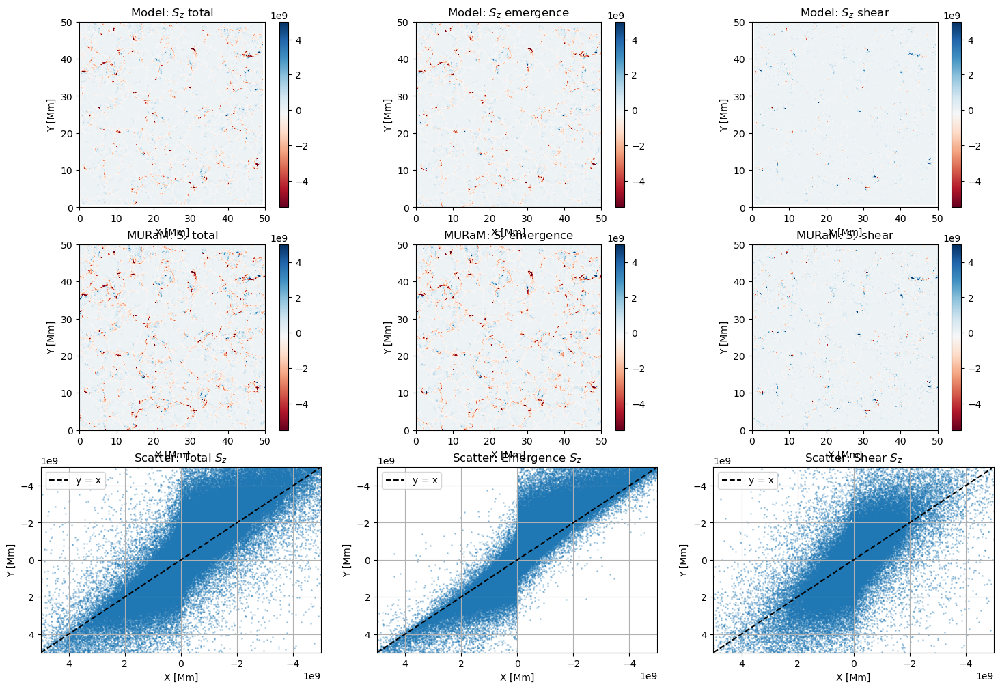

issi.plot_sz_model_vs_muram: sz plot saved in: /Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/sz_shear_emerg_comparison_Liu_DAVE4VMWDV_vx_vy_vz_fwhm0_dt30_tau_slice_1.0.000150.pdf


In [2]:
#Comparison of Sz: Parameters:
bmag_threshold=10 # only show pixels above |B|>150 Gauss
box_extent=[0, 50, 0, 50] #coordinates of the cutout in pixels to show
vscale4colortable=-5e9 #scale for Sz to show

issi.plot_sz_model_vs_muram(
    s_model_z, s_model_z_emergence, s_model_z_shear,
    s_muram_z, s_muram_z_emergence, s_muram_z_shear,directory=comparison_directory,fname=fname,
    mask=(bmag > bmag_threshold),
    extent=box_extent,
    vmin=-vscale4colortable,
    vmax=vscale4colortable
)

# Combining all analysis metric files from different methods into one panda frame and then a csv file: metrics_file

In [6]:
metrics_file="method_performance_all.csv"

df_all, summary = issi.read_all_csvs_in_directory(comparison_directory)

df_all

df_all.to_csv(comparison_directory+metrics_file, index=False)


# Sort the metrics from all methods by performance

In [7]:
combined_metrics_file="combined_method_performance_all.csv"

summary_df_by_tau = issi.summarize_method_performance_by_tau_safe(df_all)
summary_df_by_tau.head(20)

summary_df_by_tau.to_csv(comparison_directory+combined_metrics_file, index=False)


# Additional helpful programs

# 1a. Create a movie of Muram Variables: B, V, E


In [6]:
#muram data
muram_data_path = '/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'
#comparison directory path
comparison_directory='/Volumes/ISSI_flows_2025/ISSI_MURaM/issi_inversions/inv_comparisons/'

#inversion data
tau0=0.1 #1.000  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
fwhm=0 #[100,200,600,1200,2400] km
ik=0
iter2=ik
iter1=ik 
pixelsize=16
field_type="velocity" #"velocity" or "electric"
method='FLCT Bz'  #'DAVE4VMWDV' #DAVE4VM

#set to True if you want to create a video or false
generate_images=True

# specify plotting range==================
tau_levels=[tau0]

#
vminmax_high = {
    'b_muram_x': (-200, 200),'b_muram_y': (-200, 200),'b_muram_z':(-200, 200),
    'v_muram_x': (-4, 4),'v_muram_y': (-4, 4),'v_muram_z': (-3, 3),
    'e_muram_x': (-0.5, 0.5),'e_muram_y': (-0.5, 0.5),'e_muram_z': (-0.5, 0.5)}
vminmax_low = {
    'b_muram_x': (-300, 300),'b_muram_y': (-300, 300),'b_muram_z':(-300, 300),
    'v_muram_x': (-5, 5),'v_muram_y': (-5, 5),'v_muram_z': (-5, 5),
    'e_muram_x': (-1.0, 1.0),'e_muram_y': (-1.0, 1.0),'e_muram_z': (-1.0, 1.0)}

if tau0 == 0.1:
    vminmax=vminmax_high
elif tau0 == 400:
    vminmax=vminmax_high
elif tau0 == 1.0:
    vminmax=vminmax_low
elif tau0 == 384:
    vminmax=vminmax_low
else:
    raise ValueError("tau0 must be one of 0.1, 1.0, 384, 400")

results, video_path = issi.cr_muram_video_parallel(
    path=comparison_directory,
    directory=muram_data_path,
    tau0=tau0,
    fwhm=fwhm,
    pixelsize=16,
    dt=dt,
    vminmax=vminmax,
    step=50,
    start=0,
    stop=11000,
    n_jobs=8,
    generate_images=generate_images)


❌ No JPG frames found.


# 1b. Create a movie of Muram Variables: 2 by 2, Intensity, Sz_shear, Sz_emergence, Sz total

In [7]:
#muram data
#path='/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'
path='/Volumes/ISSI_flows_2025/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/'
directory='/Volumes/ISSI_flows_2025/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/issi_inversions/inv_comparisons/'

#inversion data
tau0=0.1 #1.000  # tau=0.1, Tau=1.0, yz=0384 and yz=0400;
dt=30 #dt=[30,60,360,720],
fwhm=0 #[100,200,600,1200,2400] km
ik=0
iter2=ik
iter1=ik 
pixelsize=16
field_type="velocity" #"velocity" or "electric"
method='FLCT Bz'  #'DAVE4VMWDV' #DAVE4VM

# reading in MURAM data===================
tau_levels=[tau0]

vminmax_high = {
    'b_muram_x': (-200, 200),'b_muram_y': (-200, 200),'b_muram_z':(-200, 200),
    'v_muram_x': (-4, 4),'v_muram_y': (-4, 4),'v_muram_z': (-3, 3),
    'e_muram_x': (-0.5, 0.5),'e_muram_y': (-0.5, 0.5),'e_muram_z': (-0.5, 0.5)}
vminmax_low = {
    'b_muram_x': (-300, 300),'b_muram_y': (-300, 300),'b_muram_z':(-300, 300),
    'v_muram_x': (-5, 5),'v_muram_y': (-5, 5),'v_muram_z': (-5, 5),
    'e_muram_x': (-1.0, 1.0),'e_muram_y': (-1.0, 1.0),'e_muram_z': (-1.0, 1.0)}

if tau0 == 0.1:
    vminmax=vminmax_high
elif tau0 == 400:
    vminmax=vminmax_high
elif tau0 == 1.0:
    vminmax=vminmax_low
elif tau0 == 384:
    vminmax=vminmax_low
else:
    raise ValueError("tau0 must be one of 0.1, 1.0, 384, 400")

results, video_path = issi.cr_muram_video_parallel(
    path=path,
    directory=directory,
    tau0=tau0,
    fwhm=fwhm,
    pixelsize=16,
    dt=dt,
    vminmax=vminmax,
    step=50,
    start=0,
    stop=11000,
    n_jobs=8,generate_images=True)


❌ No JPG frames found.


# 2. Create an inductivity overview of Muram dataset for varying ds and dt: create a giant plot for that. Done!

0 0 16 30


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


0 1 64 30


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


0 2 128 30


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


0 3 256 30


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


1 0 16 60


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


1 1 64 60


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


1 2 128 60


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


1 3 256 60


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


2 0 16 120


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


2 1 64 120


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


2 2 128 120


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


2 3 256 120


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


3 0 16 360


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


3 1 64 360


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


3 2 128 360


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


3 3 256 360


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


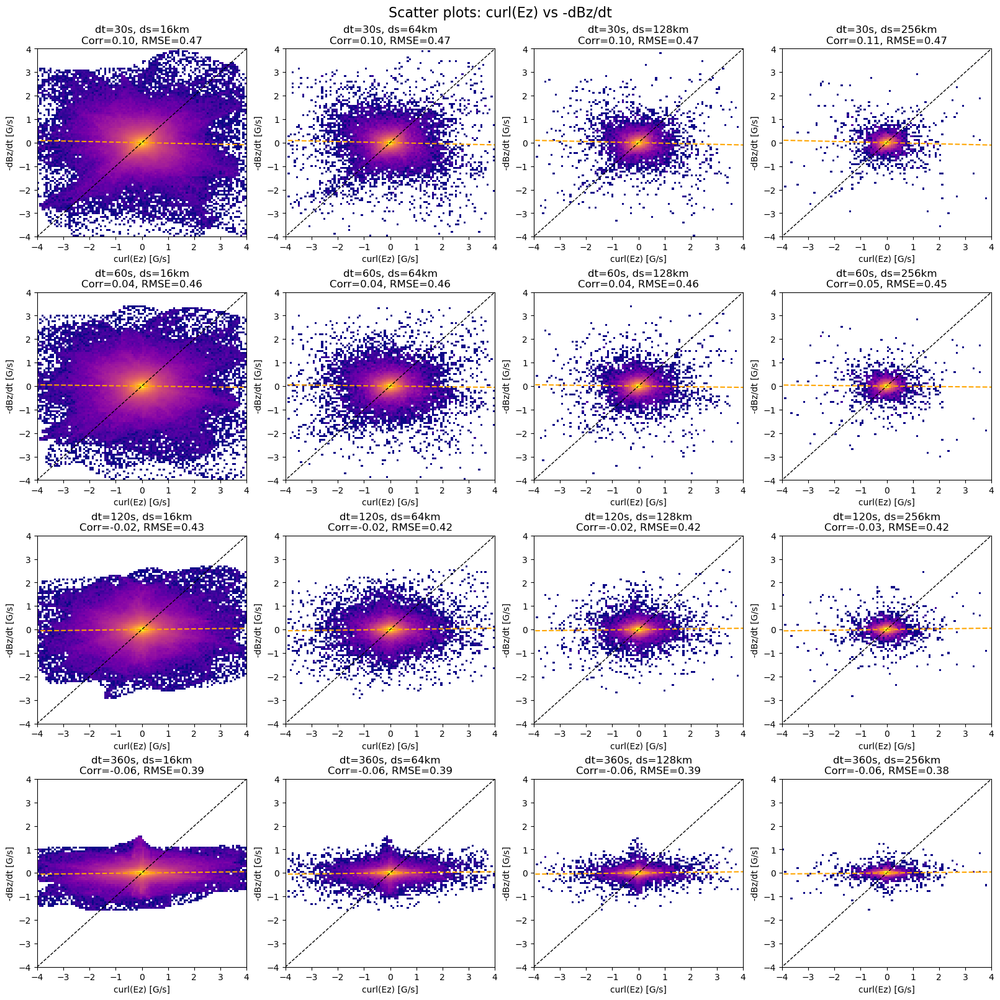

In [8]:
issi.plot_inductive_term_grid(
    path='/Users/maria2022/!Work/Globus/ISSI_MURaM_QSsm_16x16_SSD_25x8Mm_16_pdmp_1_ISSI_Flows/muram_data/',
    directory=directory,
    tau0=400,
    iter1=0,
    pixelsize_km=16,
    muram=muram,
    issi=issi)